# Accessing Data

In [2]:
#This gets us into the right directory from home, in order to run the import python script from Mat

#sys = system (module), gives information and control over python interpreter/terminal itself
import sys
sys.path.append("/home/565/pv3484/aus_substation_electricity")

#% is a magic command, special shortcut command that lets you control/interact with notebook environment (ie. gives control of terminal without writing full python code)
%cd aus_substation_electricity/

!pwd

/home/565/pv3484/aus_substation_electricity
/home/565/pv3484/aus_substation_electricity


In [3]:
#This section imports the substations that Mat put together

%run /home/565/pv3484/aus_substation_electricity/import_substation.py

processing nsw substations for ['ausgrid'] from None to None
ausgrid
following columns in demand are not in info index:
['MT_HU', 'SI_NO']
removing these columns from demand
number of substations in ausgrid substation info: 134
number of substations in ausgrid substation data: 132
following sites match selection criteria:
               energy_asset          Name  Area  Dwellings  Persons  Residential  Commercial  Industrial  Primary Production  Education  \
ID                                                                                                                                        
BLAKE         AG_BLAKEHURST    Blakehurst     7      10081    28521        0.850       0.005       0.021               0.000      0.022   
PUNCH          AG_PUNCHBOWL     Punchbowl     9      17514    50395        0.826       0.048       0.038               0.000      0.025   
MEADO         AG_MEADOWBANK    Meadowbank    15      22420    56948        0.825       0.023       0.015               0

# Anomaly Demand Timing

## Australia Day 2008

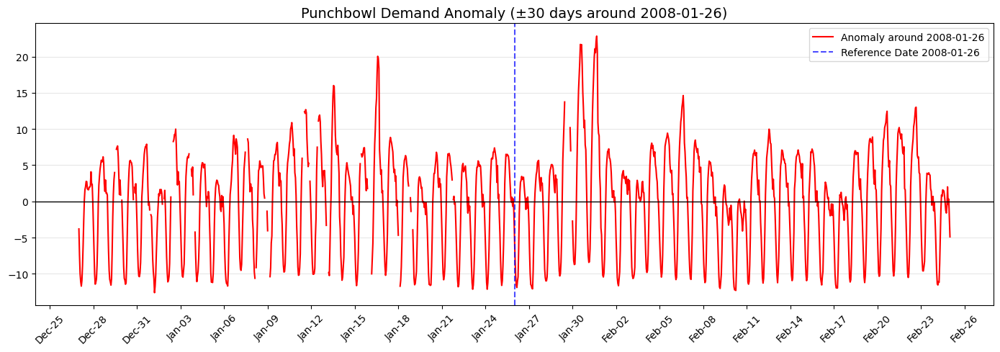

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# --- Step 1: Ensure datetime index ---
demand.index = pd.to_datetime(demand.index)

# --- Step 2: Focus on Blakehurst station ---
station = "PUNCH"   # adjust if column name differs
df = demand[[station]].copy()

# --- Step 3: Resample to hourly demand ---
hourly = df.resample("h").mean()

# --- Step 4: Choose reference date
ref_date = pd.Timestamp("2008-01-26")   # change this to any date you want

# --- Step 5: Define ±30-day window around reference date ---
start = ref_date - pd.Timedelta(days=30)
end   = ref_date + pd.Timedelta(days=30)
window = hourly.loc[start:end].copy()

# --- Step 6: Compute baseline (mean demand across this window) ---
baseline_mean = window[station].mean()

# --- Step 7: Compute anomalies (actual - mean) ---
window.loc[:, "anomaly"] = window[station] - baseline_mean

# --- Step 8: Plot results ---
plt.figure(figsize=(14,5))

plt.plot(window.index, window["anomaly"], color="red", linewidth=1.5,
         label=f"Anomaly around {ref_date.date()}")

# Baseline at 0
plt.axhline(0, color="black", linewidth=1)

# Mark reference date
plt.axvline(ref_date, color="blue", linestyle="--", alpha=0.7,
            label=f"Reference Date {ref_date.date()}")

# Notebook-style gridlines
plt.grid(axis='y', linestyle='-', linewidth=0.5, color='gray', alpha=0.3)

#Show every 3 days on x-axis
ax = plt.gca()
ax.xaxis.set_major_locator(mdates.DayLocator(interval=3))
ax.xaxis.set_major_formatter(mdates.DateFormatter("%b-%d"))
plt.xticks(rotation=45)

plt.title(f"Punchbowl Demand Anomaly (±30 days around {ref_date.date()})", fontsize=14)
plt.legend()
plt.tight_layout()

## Australia Day 2008 for all substations

/jobfs/155934098.gadi-pbs/ipykernel_424762/375801053.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(14,5))


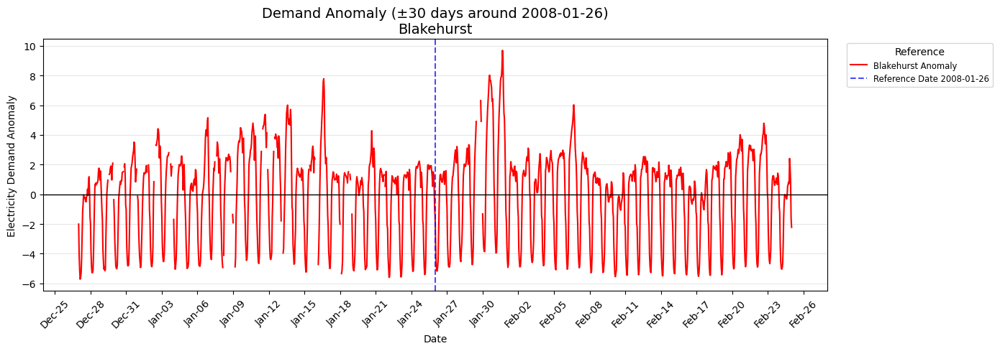

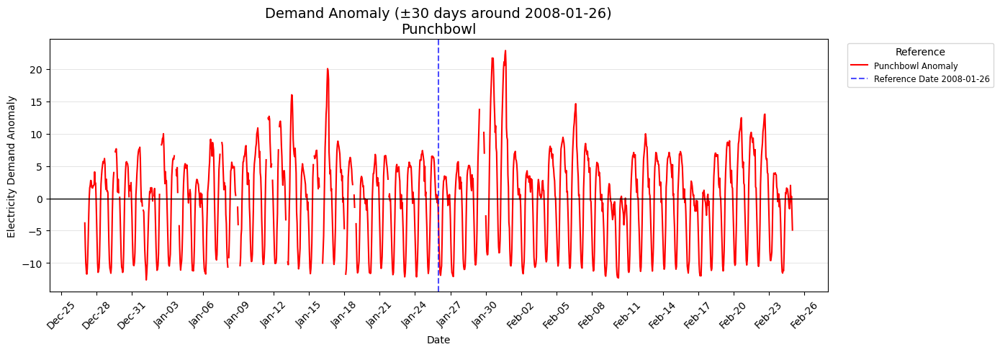

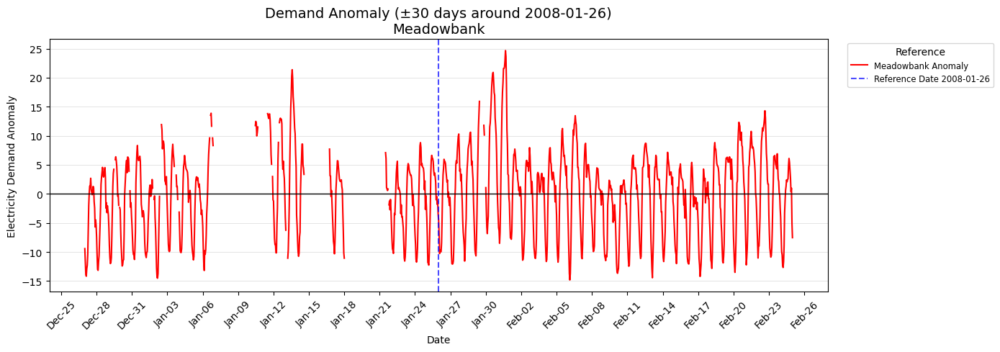

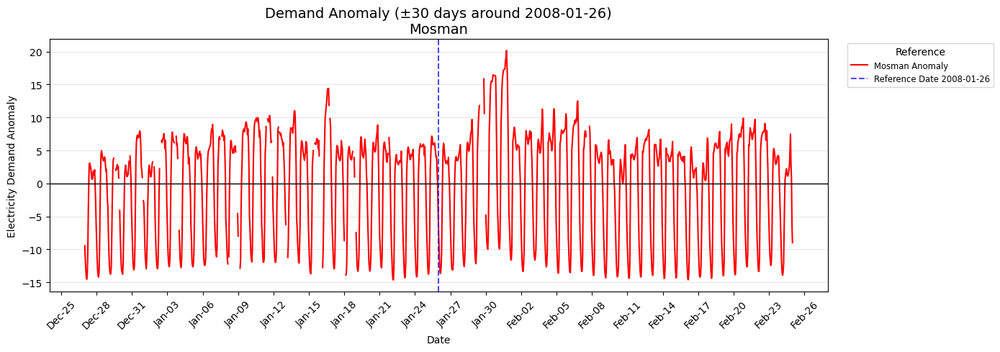

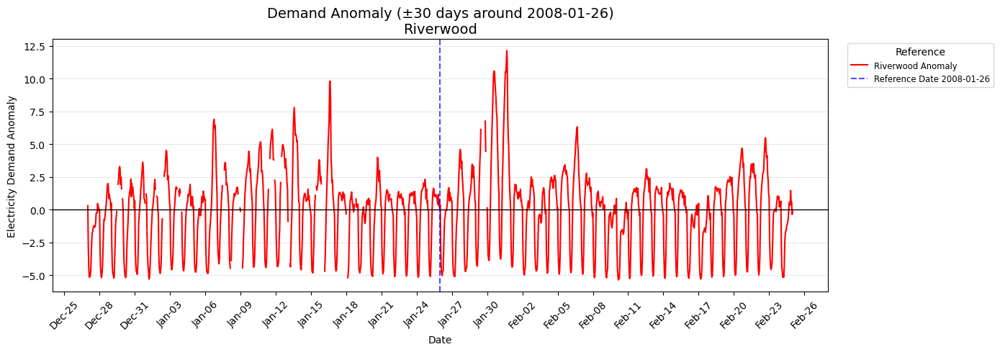

...

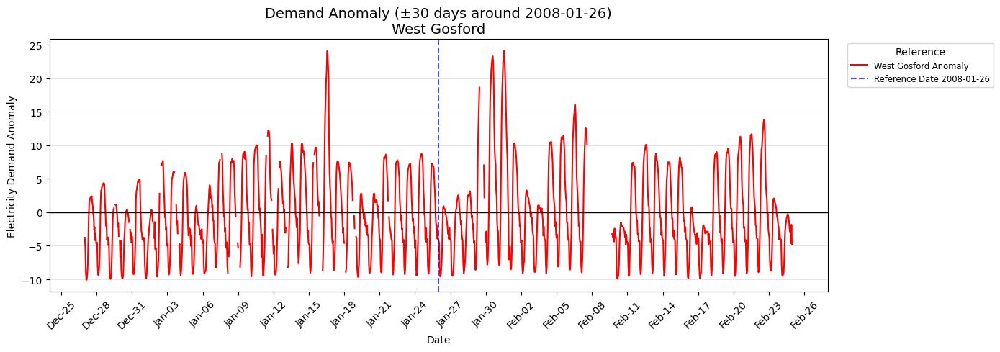

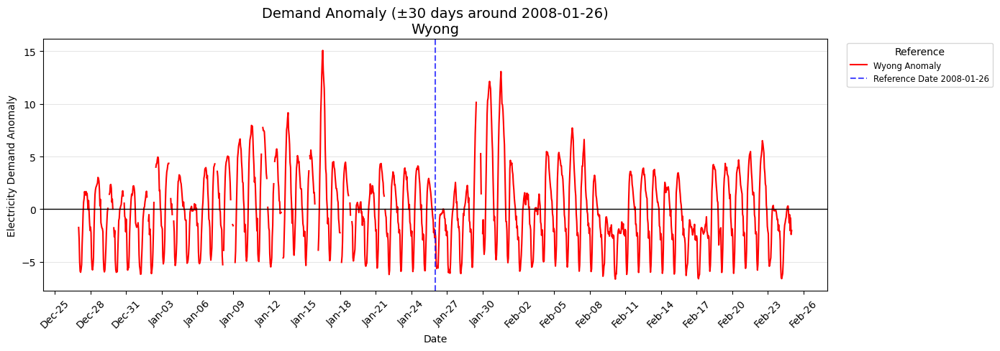

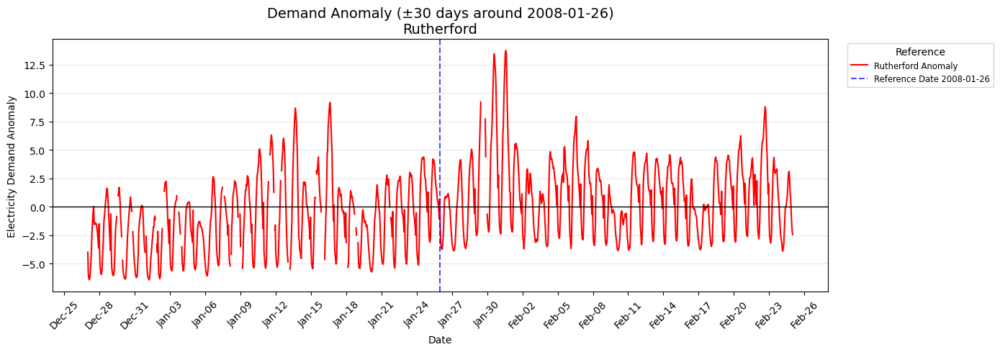

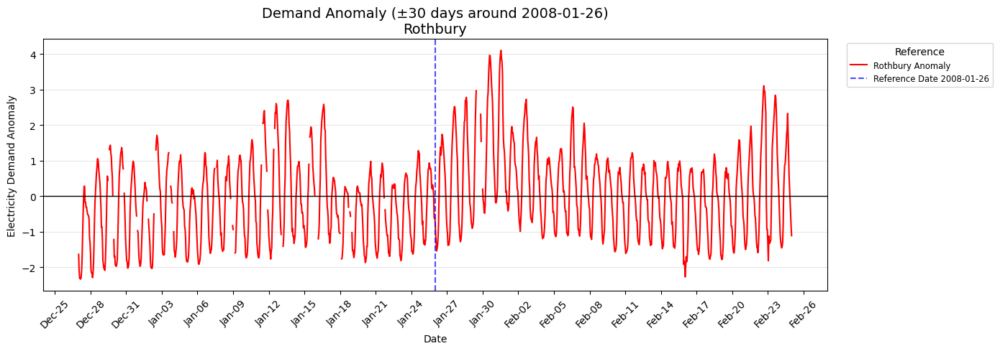

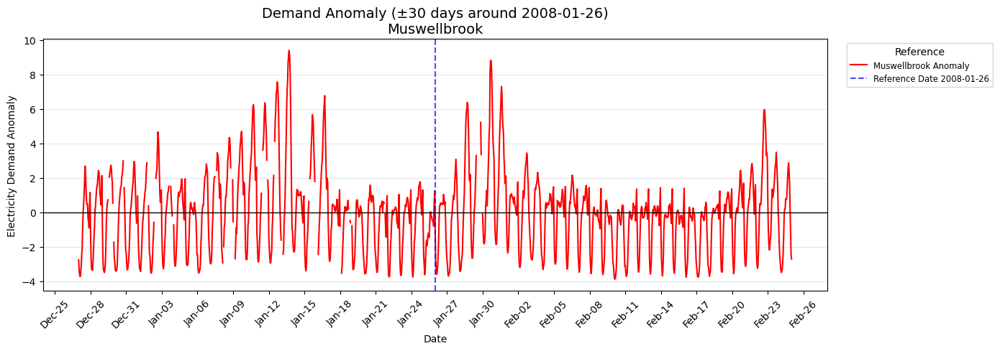

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np

# --- Step 1: Ensure datetime index ---
demand.index = pd.to_datetime(demand.index)

# --- Step 2: Resample to hourly demand ---
hourly = demand.resample("h").mean()

# --- Step 3: Choose reference date (easy to change!)
ref_date = pd.Timestamp("2008-01-26")   # change this to any date you want

# --- Step 4: Define ±30-day window around reference date ---
start = ref_date - pd.Timedelta(days=30)
end   = ref_date + pd.Timedelta(days=30)

# --- Step 5: Loop through each substation column ---
for substation in hourly.columns:
    # Slice window for this substation
    window = hourly.loc[start:end, [substation]].copy()
    
    # Compute baseline (mean demand across this window)
    baseline_mean = window[substation].mean()
    
    # Compute anomalies
    window.loc[:, "anomaly"] = window[substation] - baseline_mean
    
    # --- Step 6: Use full name + metadata from info ---
    full_name = info.loc[substation, "Name"]
    fraction = info.loc[substation, "Residential"]
    
    # --- Step 7: Plot ---
    plt.figure(figsize=(14,5))
    plt.plot(window.index, window["anomaly"], color="red", linewidth=1.5,
             label=f"{full_name} Anomaly")
    
    # Baseline at 0
    plt.axhline(0, color="black", linewidth=1)
    
    # Mark reference date
    plt.axvline(ref_date, color="blue", linestyle="--", alpha=0.7,
                label=f"Reference Date {ref_date.date()}")
    
    # Notebook-style gridlines
    plt.grid(axis='y', linestyle='-', linewidth=0.5, color='gray', alpha=0.3)
    
    # ✅ Show every 3 days on x-axis
    ax = plt.gca()
    ax.xaxis.set_major_locator(mdates.DayLocator(interval=3))
    ax.xaxis.set_major_formatter(mdates.DateFormatter("%b-%d"))
    plt.xticks(rotation=45)
    
    # --- Step 8: Title and labels with metadata ---
    plt.title(f"Demand Anomaly (±30 days around {ref_date.date()})\n"
              f"{full_name}", fontsize=14)
    plt.xlabel("Date")
    plt.ylabel("Electricity Demand Anomaly")
    plt.legend(title="Reference", bbox_to_anchor=(1.02, 1), loc="upper left", fontsize="small")
    
    plt.tight_layout()

## Australia Day Anomalies across 2 year periods

### 2005-2006

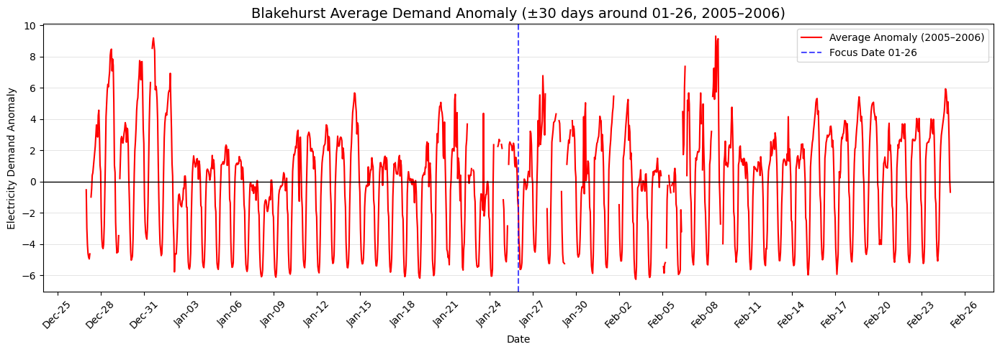

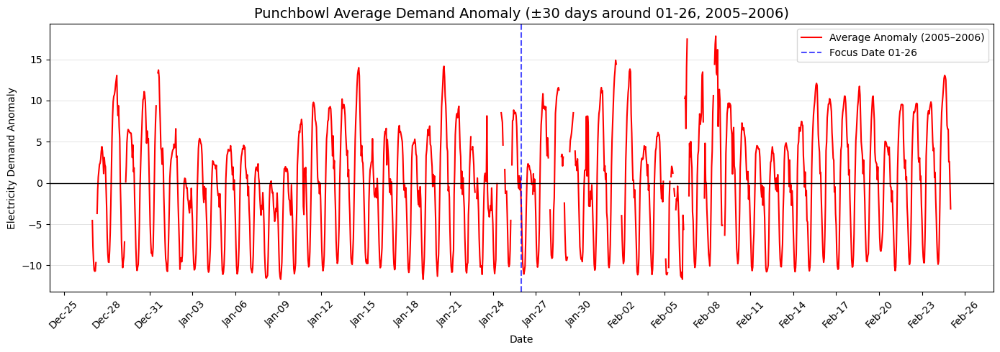

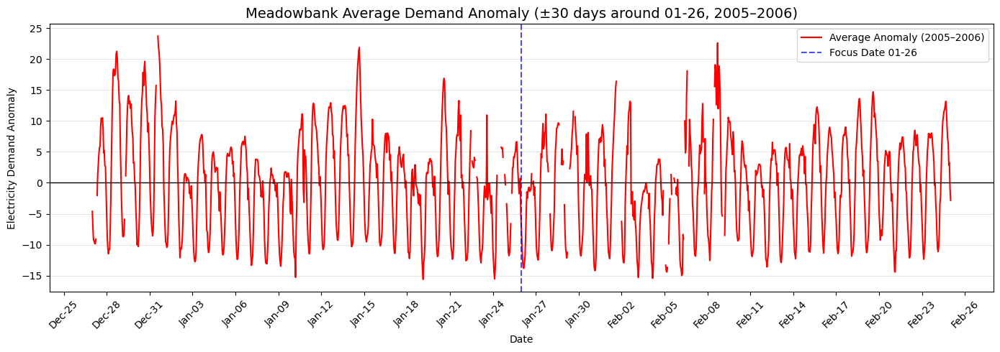

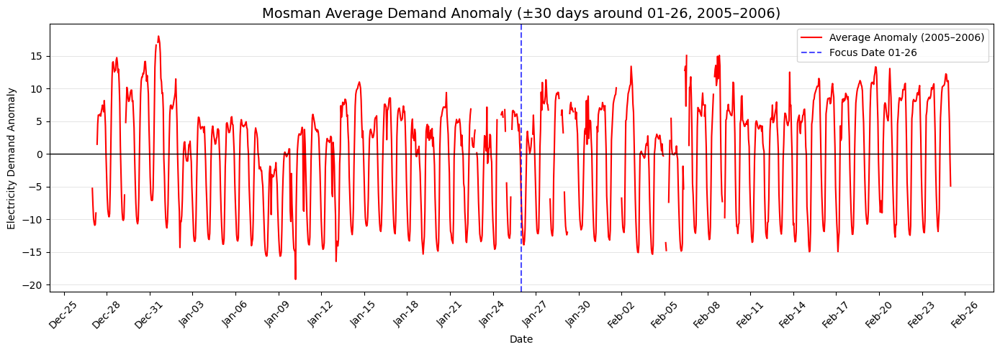

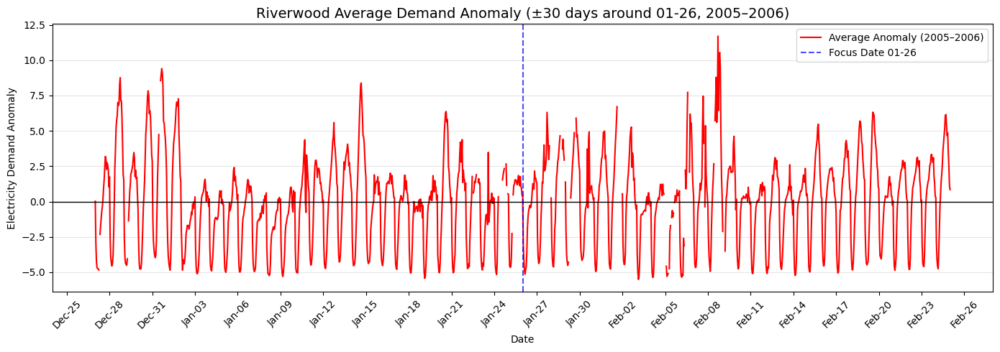

...

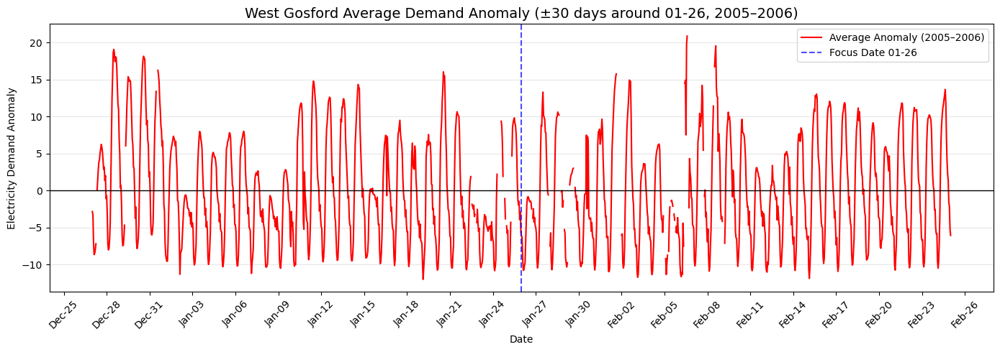

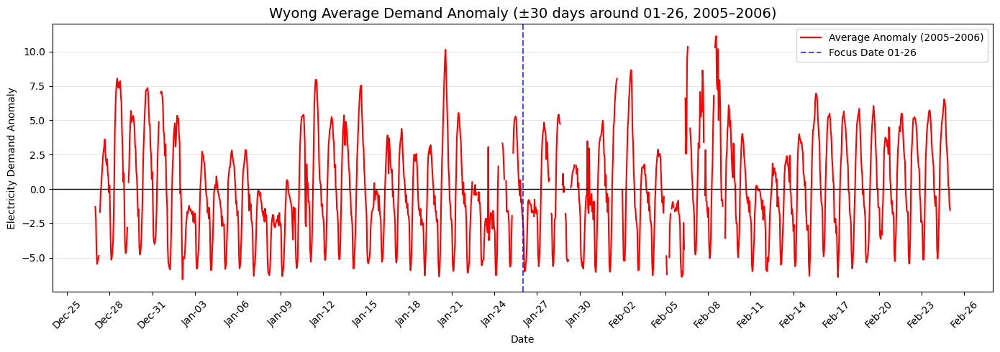

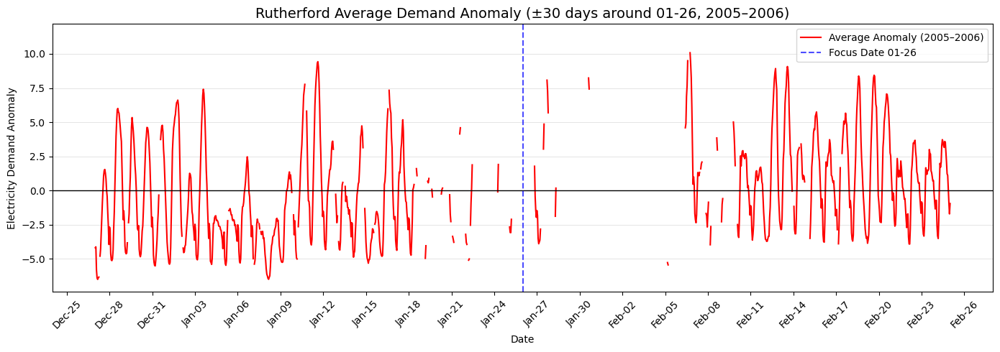

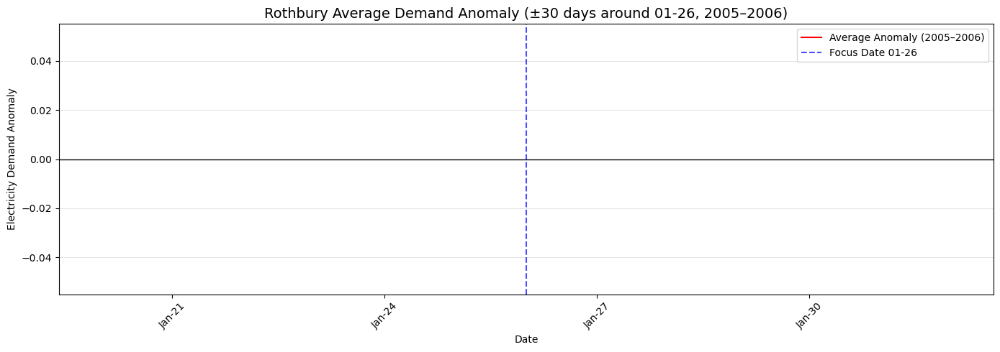

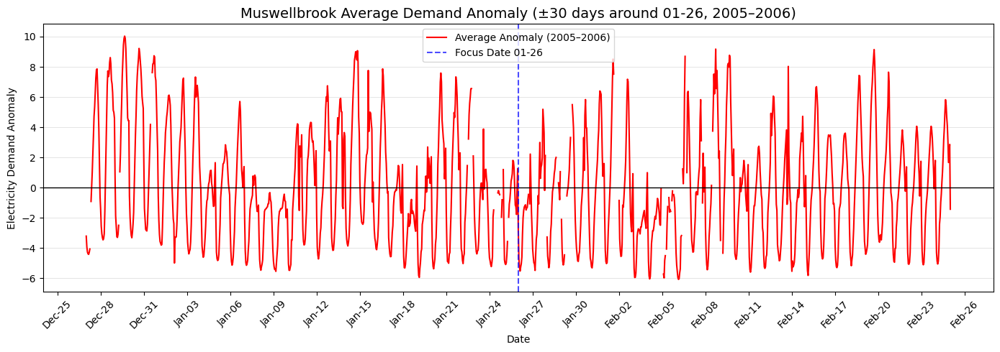

In [70]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# --- Step 1: Ensure datetime index ---
demand.index = pd.to_datetime(demand.index)

# --- Step 2: Choose focus date and years ---
focus_date = "01-26"   # e.g. Australia Day, change to "12-25" for Christmas
years = [2005, 2006]   # list of years to average

# --- Step 3: Resample to hourly demand ---
hourly = demand.resample("h").mean()

# --- Step 4: Loop through each substation ---
for station in hourly.columns:
    # Collect ±30-day windows for each year
    windows = []
    for year in years:
        ref_date = pd.Timestamp(f"{year}-{focus_date}")
        start = ref_date - pd.Timedelta(days=30)
        end   = ref_date + pd.Timedelta(days=30)
        window = hourly.loc[start:end, [station]].copy()
        window["mdh"] = window.index.strftime("%m-%d %H:%M")  # align by calendar date
        window = window.set_index("mdh")
        windows.append(window)

    # Combine all windows
    combined = pd.concat(windows, axis=1)

    # Compute baseline (mean demand across all years' windows)
    baseline_mean = combined.mean(axis=1).mean()

    # Compute anomalies for each year relative to baseline
    anomalies = combined.subtract(baseline_mean, axis=0)

    # Average anomalies across all chosen years
    avg_anomaly = anomalies.mean(axis=1)

    # Build datetime index for plotting (use first year for calendar axis)
    ref_date = pd.Timestamp(f"{years[0]}-{focus_date}")
    plot_index = pd.date_range(ref_date - pd.Timedelta(days=30),
                               ref_date + pd.Timedelta(days=30),
                               freq="h")

    # Get full substation name from metadata
    full_name = info.loc[station, "Name"]

    # --- Plot ---
    plt.figure(figsize=(14,5))
    plt.plot(plot_index, avg_anomaly.values, color="red", linewidth=1.5,
             label=f"Average Anomaly ({years[0]}–{years[-1]})")

    # Baseline at 0
    plt.axhline(0, color="black", linewidth=1)

    # Mark focus date
    plt.axvline(ref_date, color="blue", linestyle="--", alpha=0.7,
                label=f"Focus Date {focus_date}")

    # Grid and ticks
    plt.grid(axis='y', linestyle='-', linewidth=0.5, color='gray', alpha=0.3)
    ax = plt.gca()
    ax.xaxis.set_major_locator(mdates.DayLocator(interval=3))   # tick every 3 days
    ax.xaxis.set_major_formatter(mdates.DateFormatter("%b-%d"))
    plt.xticks(rotation=45)

    # Title with full substation name
    plt.title(f"{full_name} Average Demand Anomaly (±30 days around {focus_date}, {years[0]}–{years[-1]})",
              fontsize=14)
    plt.xlabel("Date")
    plt.ylabel("Electricity Demand Anomaly")
    plt.legend()
    plt.tight_layout()
    plt.show()

#2006-2007

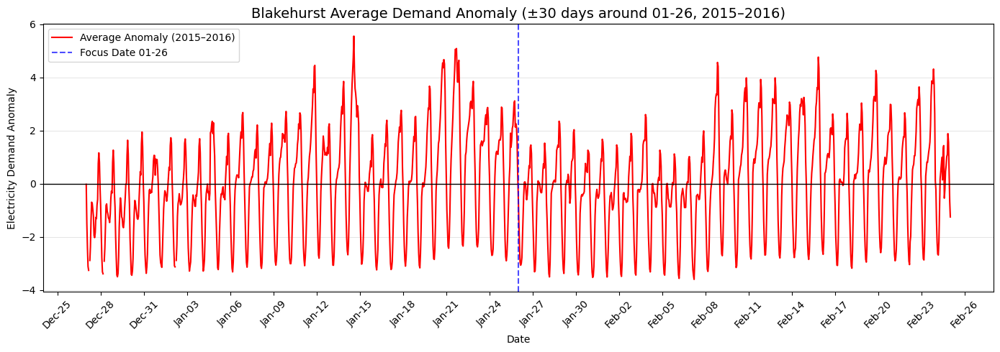

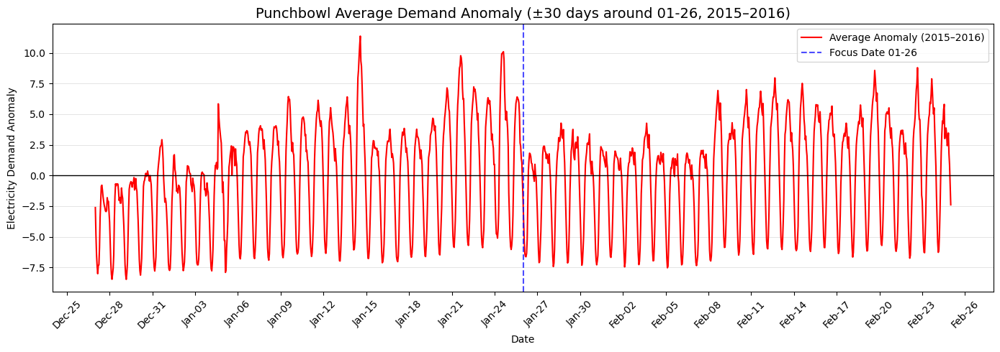

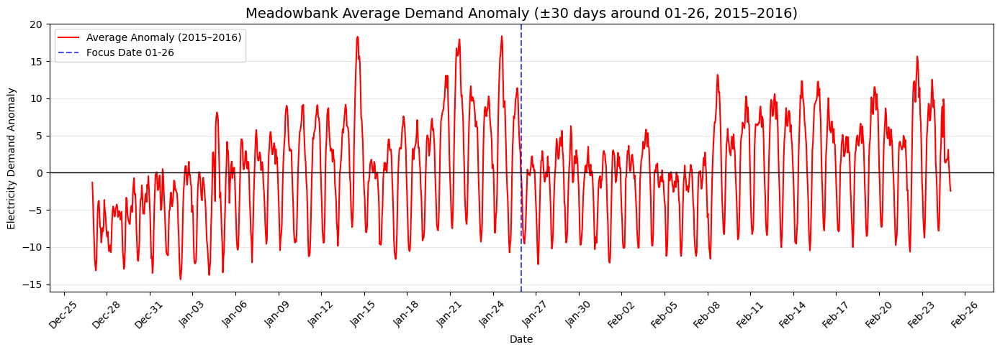

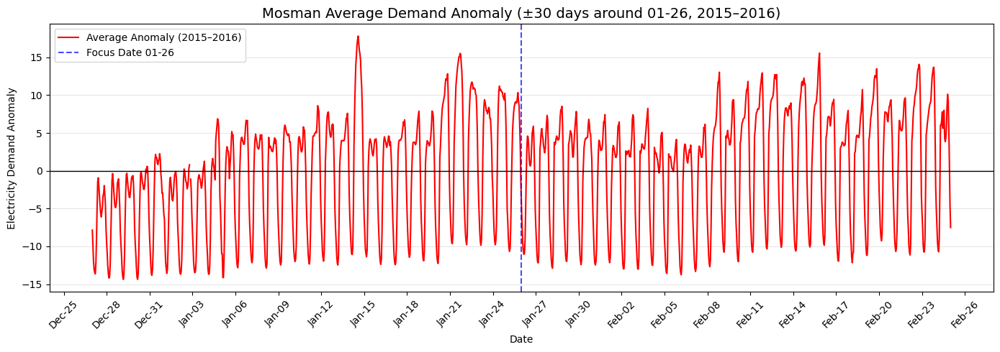

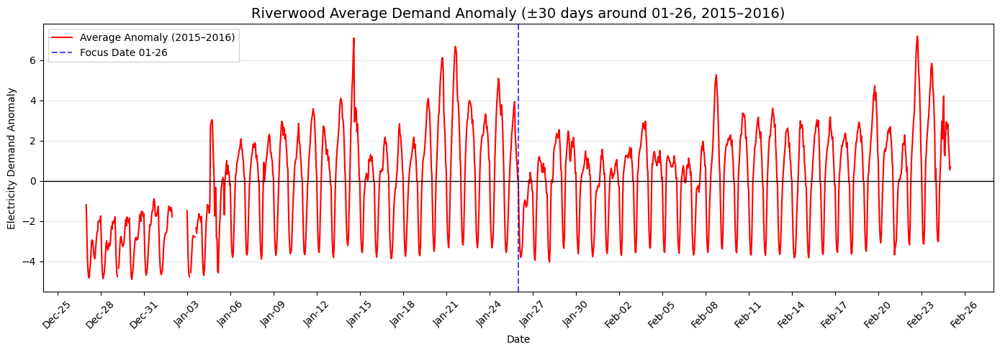

...

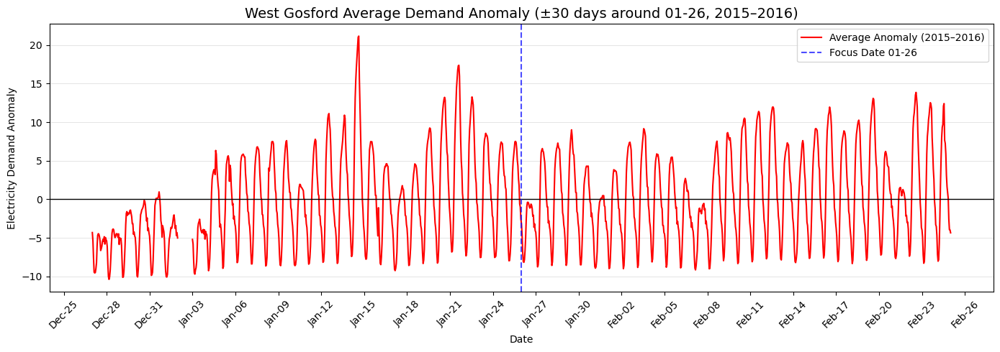

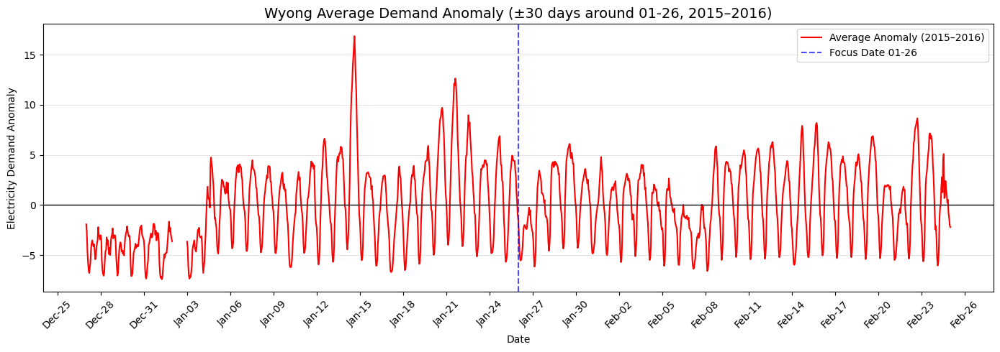

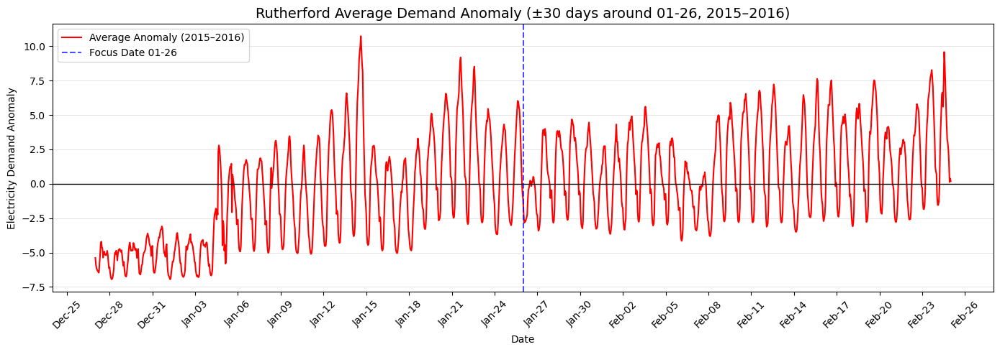

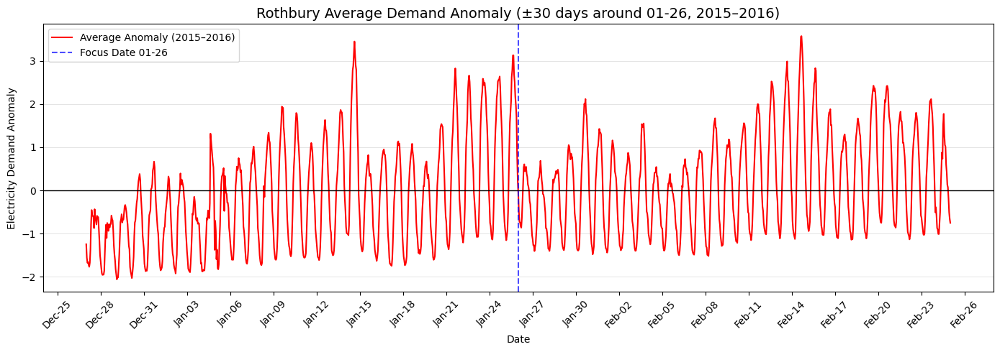

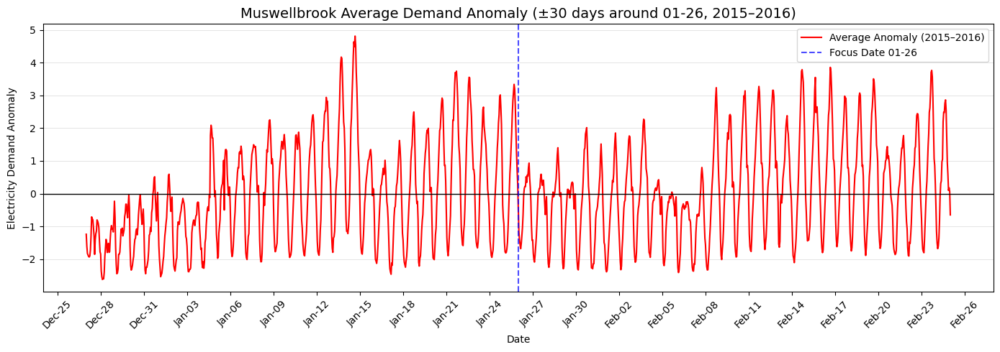

In [83]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# --- Step 1: Ensure datetime index ---
demand.index = pd.to_datetime(demand.index)

# --- Step 2: Choose focus date and years ---
focus_date = "01-26"   # e.g. Australia Day, change to "12-25" for Christmas
years = [2015, 2016]   # list of years to average

# --- Step 3: Resample to hourly demand ---
hourly = demand.resample("h").mean()

# --- Step 4: Loop through each substation ---
for station in hourly.columns:
    # Collect ±30-day windows for each year
    windows = []
    for year in years:
        ref_date = pd.Timestamp(f"{year}-{focus_date}")
        start = ref_date - pd.Timedelta(days=30)
        end   = ref_date + pd.Timedelta(days=30)
        window = hourly.loc[start:end, [station]].copy()
        window["mdh"] = window.index.strftime("%m-%d %H:%M")  # align by calendar date
        window = window.set_index("mdh")
        windows.append(window)

    # Combine all windows
    combined = pd.concat(windows, axis=1)

    # Compute baseline (mean demand across all years' windows)
    baseline_mean = combined.mean(axis=1).mean()

    # Compute anomalies for each year relative to baseline
    anomalies = combined.subtract(baseline_mean, axis=0)

    # Average anomalies across all chosen years
    avg_anomaly = anomalies.mean(axis=1)

    # Build datetime index for plotting (use first year for calendar axis)
    ref_date = pd.Timestamp(f"{years[0]}-{focus_date}")
    plot_index = pd.date_range(ref_date - pd.Timedelta(days=30),
                               ref_date + pd.Timedelta(days=30),
                               freq="h")

    # Get full substation name from metadata
    full_name = info.loc[station, "Name"]

    # --- Plot ---
    plt.figure(figsize=(14,5))
    plt.plot(plot_index, avg_anomaly.values, color="red", linewidth=1.5,
             label=f"Average Anomaly ({years[0]}–{years[-1]})")

    # Baseline at 0
    plt.axhline(0, color="black", linewidth=1)

    # Mark focus date
    plt.axvline(ref_date, color="blue", linestyle="--", alpha=0.7,
                label=f"Focus Date {focus_date}")

    # Grid and ticks
    plt.grid(axis='y', linestyle='-', linewidth=0.5, color='gray', alpha=0.3)
    ax = plt.gca()
    ax.xaxis.set_major_locator(mdates.DayLocator(interval=3))   # tick every 3 days
    ax.xaxis.set_major_formatter(mdates.DateFormatter("%b-%d"))
    plt.xticks(rotation=45)

    # Title with full substation name
    plt.title(f"{full_name} Average Demand Anomaly (±30 days around {focus_date}, {years[0]}–{years[-1]})",
              fontsize=14)
    plt.xlabel("Date")
    plt.ylabel("Electricity Demand Anomaly")
    plt.legend()
    plt.tight_layout()
    plt.show()

### 2012 - 2013

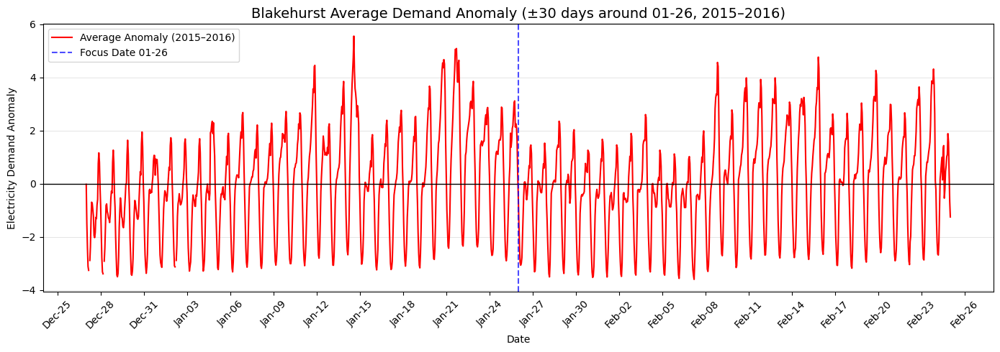

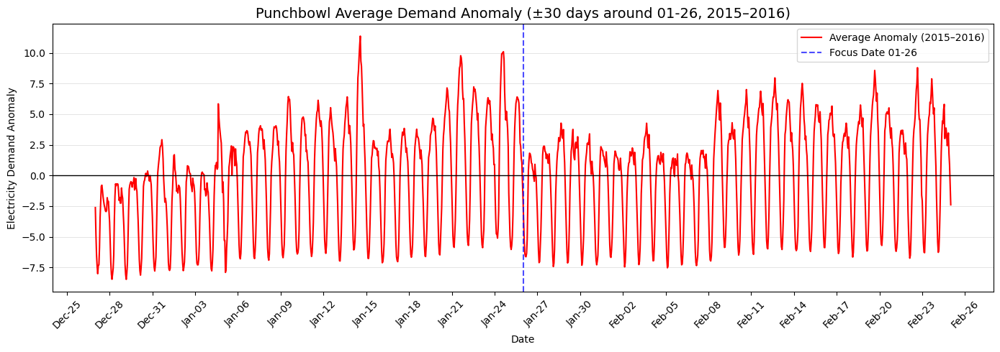

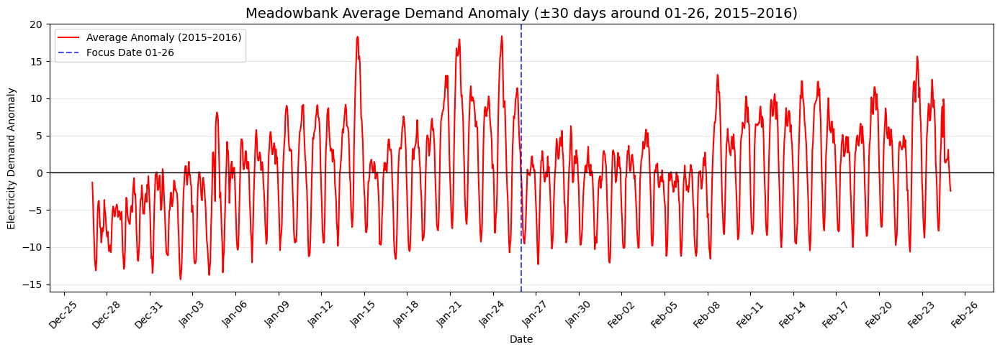

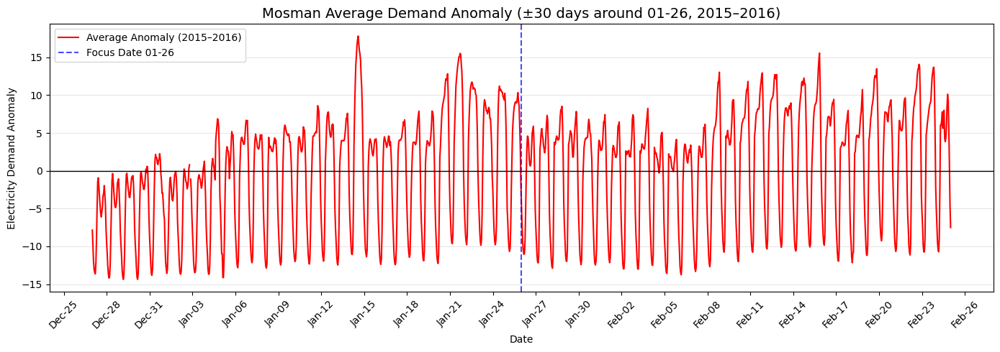

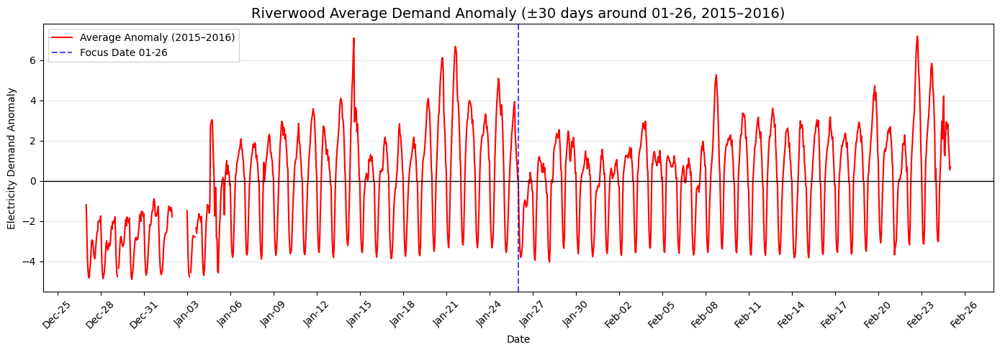

...

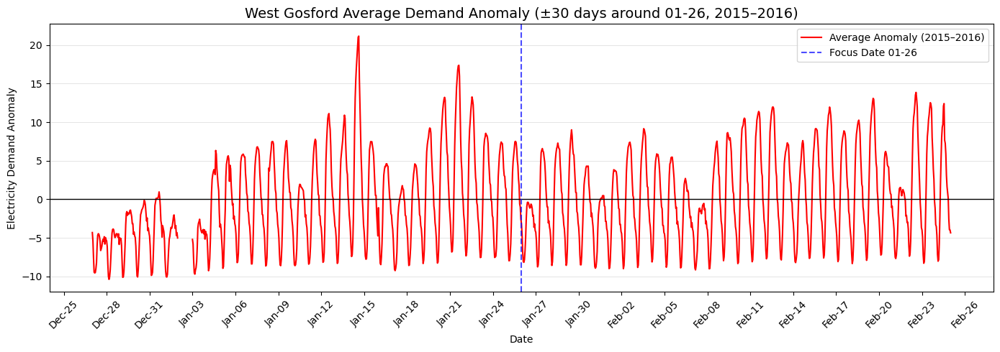

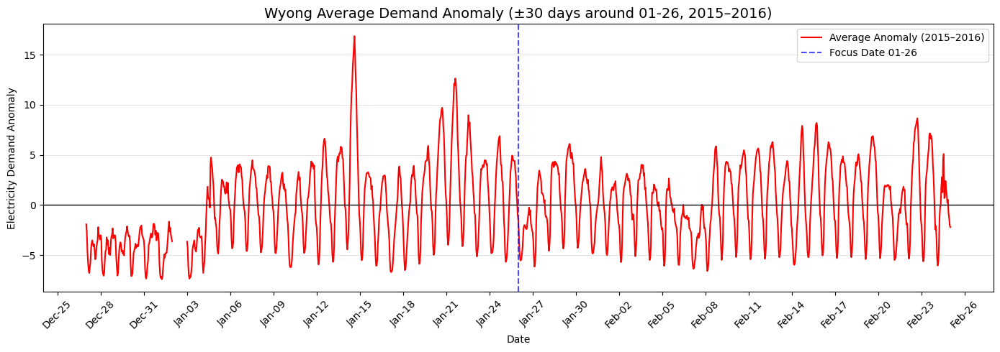

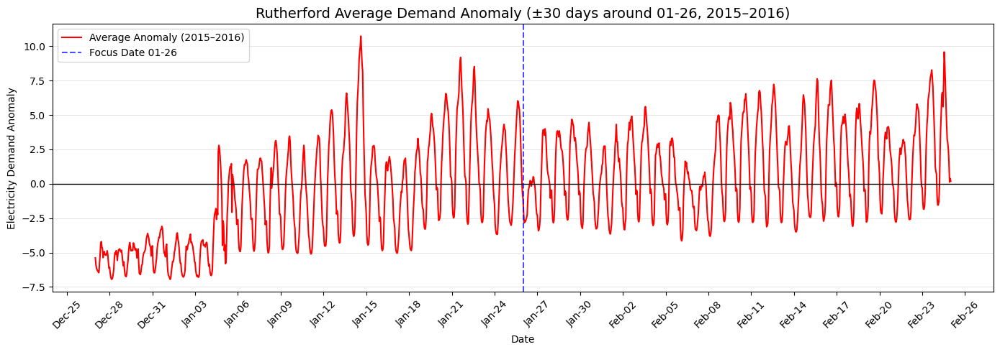

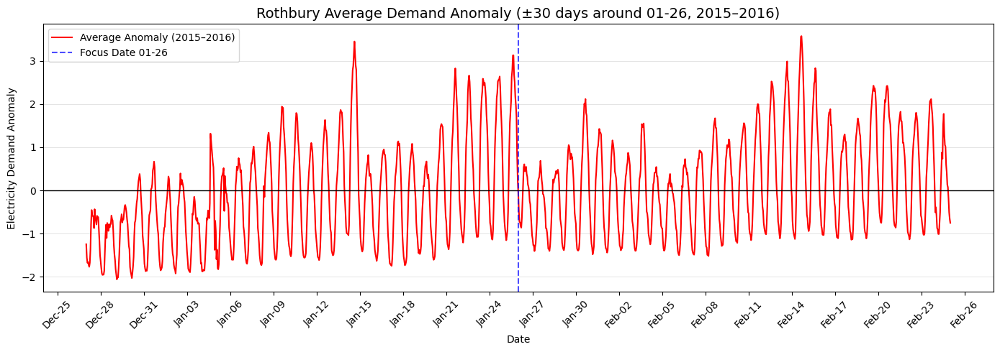

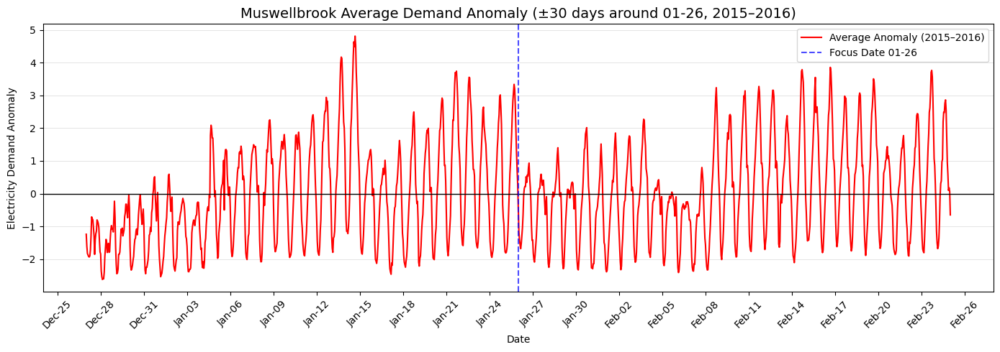

In [77]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# --- Step 1: Ensure datetime index ---
demand.index = pd.to_datetime(demand.index)

# --- Step 2: Choose focus date and years ---
focus_date = "01-26"   # e.g. Australia Day, change to "12-25" for Christmas
years = [2015, 2016]   # list of years to average

# --- Step 3: Resample to hourly demand ---
hourly = demand.resample("h").mean()

# --- Step 4: Loop through each substation ---
for station in hourly.columns:
    # Collect ±30-day windows for each year
    windows = []
    for year in years:
        ref_date = pd.Timestamp(f"{year}-{focus_date}")
        start = ref_date - pd.Timedelta(days=30)
        end   = ref_date + pd.Timedelta(days=30)
        window = hourly.loc[start:end, [station]].copy()
        window["mdh"] = window.index.strftime("%m-%d %H:%M")  # align by calendar date
        window = window.set_index("mdh")
        windows.append(window)

    # Combine all windows
    combined = pd.concat(windows, axis=1)

    # Compute baseline (mean demand across all years' windows)
    baseline_mean = combined.mean(axis=1).mean()

    # Compute anomalies for each year relative to baseline
    anomalies = combined.subtract(baseline_mean, axis=0)

    # Average anomalies across all chosen years
    avg_anomaly = anomalies.mean(axis=1)

    # Build datetime index for plotting (use first year for calendar axis)
    ref_date = pd.Timestamp(f"{years[0]}-{focus_date}")
    plot_index = pd.date_range(ref_date - pd.Timedelta(days=30),
                               ref_date + pd.Timedelta(days=30),
                               freq="h")

    # Get full substation name from metadata
    full_name = info.loc[station, "Name"]

    # --- Plot ---
    plt.figure(figsize=(14,5))
    plt.plot(plot_index, avg_anomaly.values, color="red", linewidth=1.5,
             label=f"Average Anomaly ({years[0]}–{years[-1]})")

    # Baseline at 0
    plt.axhline(0, color="black", linewidth=1)

    # Mark focus date
    plt.axvline(ref_date, color="blue", linestyle="--", alpha=0.7,
                label=f"Focus Date {focus_date}")

    # Grid and ticks
    plt.grid(axis='y', linestyle='-', linewidth=0.5, color='gray', alpha=0.3)
    ax = plt.gca()
    ax.xaxis.set_major_locator(mdates.DayLocator(interval=3))   # tick every 3 days
    ax.xaxis.set_major_formatter(mdates.DateFormatter("%b-%d"))
    plt.xticks(rotation=45)

    # Title with full substation name
    plt.title(f"{full_name} Average Demand Anomaly (±30 days around {focus_date}, {years[0]}–{years[-1]})",
              fontsize=14)
    plt.xlabel("Date")
    plt.ylabel("Electricity Demand Anomaly")
    plt.legend()
    plt.tight_layout()
    plt.show()